# Import Libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import warnings
warnings.filterwarnings("ignore")

# Read Data

In [2]:
data = pd.read_csv("E:\Song Recommender\dataset\data.csv")
genre_data = pd.read_csv("E:\Song Recommender\dataset\data_by_genres.csv")
year_data = pd.read_csv("E:\Song Recommender\dataset\data_by_year.csv")

In [3]:
print(f"data : {data.shape}")
print(f"genre_data : {genre_data.shape}")
print(f"year_data : {year_data.shape}")

data : (170653, 19)
genre_data : (2973, 14)
year_data : (100, 14)


In [4]:
data.head(3)

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339


In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [6]:
genre_data.head()

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.361600,-31.514333,0.040567,75.336500,0.103783,27.833333,6
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.131000,-16.854000,0.076817,120.285667,0.221750,52.500000,5
2,1,8-bit,0.762000,0.712000,1.151770e+05,0.818000,0.876000,0.126000,-9.180000,0.047000,133.444000,0.975000,48.000000,7
3,1,[],0.651417,0.529093,2.328809e+05,0.419146,0.205309,0.218696,-12.288965,0.107872,112.857352,0.513604,20.859882,7
4,1,a cappella,0.676557,0.538961,1.906285e+05,0.316434,0.003003,0.172254,-12.479387,0.082851,112.110362,0.448249,45.820071,7


In [7]:
genre_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB


In [8]:
year_data.head()

,mode,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,1921,0.886896,0.418597,260537.166667,0.231815,0.344878,0.205710,-17.048667,0.073662,101.531493,0.379327,0.653333,2
1,1,1922,0.938592,0.482042,165469.746479,0.237815,0.434195,0.240720,-19.275282,0.116655,100.884521,0.535549,0.140845,10
2,1,1923,0.957247,0.577341,177942.362162,0.262406,0.371733,0.227462,-14.129211,0.093949,114.010730,0.625492,5.389189,0
3,1,1924,0.940200,0.549894,191046.707627,0.344347,0.581701,0.235219,-14.231343,0.092089,120.689572,0.663725,0.661017,10
4,1,1925,0.962607,0.573863,184986.924460,0.278594,0.418297,0.237668,-14.146414,0.111918,115.521921,0.621929,2.604317,5


In [9]:
year_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB


# EDA

## Song dataset

### Finding the pearson correlation coefficient between features and popularity of song

In [10]:
## data
data_pc = data.drop(["artists", "id", "name", "release_date"], axis=1)
corr_features_popularity = {}
for col in data_pc.columns :
    corr_features_popularity[col] = data_pc[col].corr(data_pc["popularity"])

In [11]:
corr_features_popularity_Series = pd.Series(corr_features_popularity)

In [12]:
corr_features_popularity_df = pd.DataFrame(corr_features_popularity_Series, columns=["Pearson Coefficient"])

In [13]:
px.bar(corr_features_popularity_df,x="Pearson Coefficient", orientation="h")

- The year feature is highly correlated with the popularity of songs
- The acousticness feature is highly negatively correlated with the popularity of songs

### Heatmap to find the correlation between features

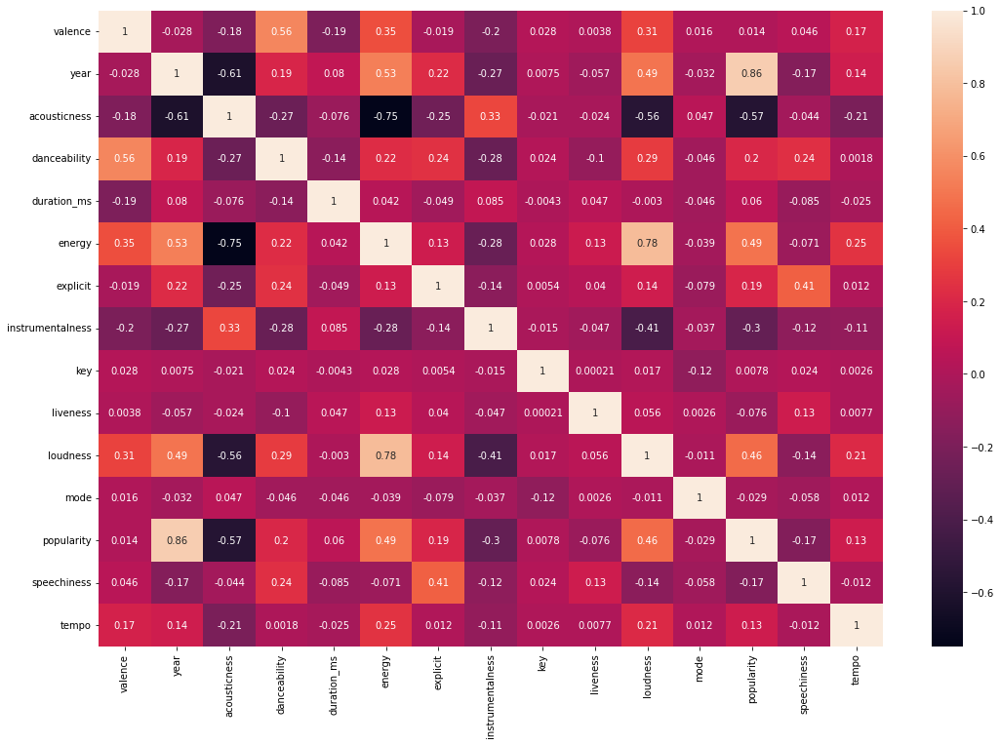

In [14]:
# data_pc.corr()
plt.figure(figsize=(18,12))
sns.heatmap(data_pc.corr(), annot=True)
plt.show()

- From the heatmap it is clear that there a high multicolinearity between the features of songs

## Genre dataset

In [15]:
data_genre = genre_data.copy()

In [16]:
data_genre.head(2)

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.3616,-31.514333,0.040567,75.336500,0.103783,27.833333,6
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.1310,-16.854000,0.076817,120.285667,0.221750,52.500000,5


In [17]:
top_10_genres = data_genre.nlargest(5, "popularity")
fig = px.bar(top_10_genres, x="genres", y=["acousticness", "danceability", "energy", "liveness", "speechiness", "valence"], barmode="group")
fig.show()

- The above graph will help us to analyze songs features with respect to genres

### Year Dataset

In [18]:
data_year = year_data.copy()

In [19]:
data_year.head(2)

,mode,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,1921,0.886896,0.418597,260537.166667,0.231815,0.344878,0.20571,-17.048667,0.073662,101.531493,0.379327,0.653333,2
1,1,1922,0.938592,0.482042,165469.746479,0.237815,0.434195,0.24072,-19.275282,0.116655,100.884521,0.535549,0.140845,10


In [20]:
sound_features = ["acousticness", "danceability", "energy", "liveness", "speechiness", "valence"]
px.line(data_year, x="year", y=sound_features)

In [21]:
px.line(data_year, x="year", y="popularity")

# Cluster Genres with K-means

In [22]:
cluster_pipeline = Pipeline([("scaler", StandardScaler()), ("kmeans", KMeans(n_clusters=10))])
X = data_genre.select_dtypes(np.number)
cluster_pipeline.fit(X)
data_genre["cluster"] = cluster_pipeline.predict(X)

In [23]:
tsne_pipeline = Pipeline([("scaler", StandardScaler()), ("tsne", TSNE())])
genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(genre_embedding, columns=["x", "y"])
projection["genres"] = data_genre["genres"]
projection["cluster"] = data_genre["cluster"]

In [24]:
fig = px.scatter(projection, x="x", y="y", color="cluster")
fig.show()

# Cluster songs with K-means

In [25]:
data1 = data.copy()

In [26]:
song_cluster_pipeline = Pipeline([("scaler", StandardScaler()), ("kmeans", KMeans(n_clusters=10))])
X = data1.select_dtypes(np.number)
song_cluster_pipeline.fit(X)
data1["cluster"] = song_cluster_pipeline.predict(X)

In [27]:
song_cluster_pca_pipeline = Pipeline([("scaler", StandardScaler()), ("PCA", PCA(n_components=2))])
song_embedding = song_cluster_pca_pipeline.fit_transform(X)
projection_song = pd.DataFrame(song_embedding, columns=["x","y"])
projection_song["song"] = data1["name"]
projection_song["cluster"] = data1["cluster"]

In [28]:
fig_2 = px.scatter(projection_song, x="x", y="y", color="cluster")
fig_2.show()

- Based on the analysis and visualizations, we can say that the songs with similar feature values tend to be closer to each other also similar genres are clustered together

# Spotify API

In [29]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict
from collections import defaultdict

In [30]:
import yaml
with open("configuration.yaml", "r") as credentials :
    credential = yaml.safe_load(credentials)

In [31]:
credential

{'spotify': {'client_id': '67d92caf80814ae386c16dbdc73f1b2a',
  'client_secret': 'a5f543adde11495eba6d148811ec7b6e'}}

In [32]:
sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id=credential["spotify"]["client_id"], 
                                                           client_secret=credential["spotify"]["client_secret"]))

In [33]:
def find_song(song_name) : 
    results = sp.search(q="track: {}".format(song_name), limit=1)
    results2 = results["tracks"]["items"][0]
    track_id = results2["id"]
    audio_features = sp.audio_features(track_id)[0]
    audio_features
    song_data = defaultdict()
    year = int(results["tracks"]["items"][0]["album"]["release_date"].split("-")[0])
    song_data["name"] = [song_name]
    song_data["year"] = [year]
    song_data["explicit"] = [int(results2["explicit"])]
    song_data["duration_ms"] = [results2["duration_ms"]]
    song_data["popularity"] = [results2["popularity"]]

    for key, value in audio_features.items() :
        song_data[key] = value

    return pd.DataFrame(song_data)

In [34]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib

features_cols = ["mode", "acousticness", "danceability", "duration_ms", "energy", "instrumentalness", "liveness", 
                 "loudness", "speechiness", "tempo", "valence", "popularity", "key", "year", "explicit"]

In [35]:
def get_song_data(song, spotify_data):
    
    try:
        song_data = spotify_data[spotify_data.name == song].iloc[0]
        return song_data
    
    except IndexError:
        song_data = find_song(song)
        return song_data

In [36]:
def get_mean_vector(song, spotify_data) :
    song_vector = []
    
    song_Data = get_song_data(song, spotify_data)

    song_vector.append(song_Data[features_cols].values)

    return np.mean(song_vector, axis=0)

In [37]:
def recommend_songs(song, spotify_data, n_songs):
    
    try :
        song_center = get_mean_vector(song, spotify_data)
    except IndexError :
        print(f"{song} does not found in Spotify or in database")
        return
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[features_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1,-1))
    distances = cdist(scaled_song_center, scaled_data, "cosine")
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    rec_songs = spotify_data.iloc[index]
    cols = ["name", "release_date", "artists", "popularity"]
    result = rec_songs[cols].to_dict(orient = "records")
    
    song_names = []
    for i in range(n_songs) :
        song_names.append(result[i]["name"])
    song_links = []
    for song in song_names :
        song_links.append(list(find_song(song)["uri"])[0])
    for i in range(n_songs) :
        result[i]["link"] = song_links[i]
    return result

In [38]:
recommend_songs("arcade", data, 5)

[{'name': 'Arcade',
  'release_date': '2019-03-07',
  'artists': "['Duncan Laurence']",
  'popularity': 81,
  'link': 'spotify:track:1Xi84slp6FryDSCbzq4UCD'},
 {'name': 'Always Afternoon',
  'release_date': '2019-05-10',
  'artists': "['Medasin', 'Kathleen']",
  'popularity': 64,
  'link': 'spotify:track:6GMaQmdpwGolGyuW6ZJ9X9'},
 {'name': 'Sólo para Ti',
  'release_date': '2006',
  'artists': "['Camila']",
  'popularity': 63,
  'link': 'spotify:track:0GNWo2IgoBKdk10gdnaSVk'},
 {'name': 'Around Me',
  'release_date': '2018-10-19',
  'artists': "['Brent Faiyaz']",
  'popularity': 63,
  'link': 'spotify:track:119c93MHjrDLJTApCVGpvx'},
 {'name': 'Lady May',
  'release_date': '2017-08-04',
  'artists': "['Tyler Childers']",
  'popularity': 75,
  'link': 'spotify:track:3t5OV1asJHmOlf23T08CLv'}]

In [39]:
recommend_songs("jxxfcsjtx", data, 3)

jxxfcsjtx does not found in Spotify or in database


In [40]:
recommend_songs("kuch is tarah", data, 5)

[{'name': "Them That's Not",
  'release_date': '2001-06-28',
  'artists': "['J-Live']",
  'popularity': 48,
  'link': 'spotify:track:0bY6SdYZcid3fzp7im837v'},
 {'name': 'Bling Bling',
  'release_date': '1999-04-20',
  'artists': "['B.G.']",
  'popularity': 50,
  'link': 'spotify:track:0wwPcA6wtMf6HUMpIRdeP7'},
 {'name': 'My Mind Playin Tricks on Me',
  'release_date': '1992-11-17',
  'artists': "['Geto Boys']",
  'popularity': 45,
  'link': 'spotify:track:4YH7AZpdCXEAGOsSAZYPOq'},
 {'name': 'Hate In Yo Eyes',
  'release_date': '2001-01-01',
  'artists': "['Mack 10']",
  'popularity': 45,
  'link': 'spotify:track:2nclWGpHxqsdJJfUIko1xA'},
 {'name': 'Useless - 2007 Remaster',
  'release_date': '1997-04-14',
  'artists': "['Depeche Mode']",
  'popularity': 44,
  'link': 'spotify:track:1BjWRLxcpNwVnjYWzhOTIF'}]

In [41]:
recommend_songs("raabta", data, 5)

[{'name': 'Tu Carcel - En Vivo Desde Tijuana, Mexico/2004',
  'release_date': '2004-01-01',
  'artists': "['Los Enanitos Verdes']",
  'popularity': 64,
  'link': 'spotify:track:1lAFWiaVhJhvQ5Gtzp6vSu'},
 {'name': 'Vanished',
  'release_date': '2008-03-18',
  'artists': "['Crystal Castles']",
  'popularity': 61,
  'link': 'spotify:track:0Q2YGyMeeZMAvzebtxoQ5f'},
 {'name': 'Black Betty',
  'release_date': '1977-06-20',
  'artists': "['Ram Jam']",
  'popularity': 67,
  'link': 'spotify:track:6kooDsorCpWVMGc994XjWN'},
 {'name': "Don't You Remember",
  'release_date': '2011-01-19',
  'artists': "['Adele']",
  'popularity': 65,
  'link': 'spotify:track:4g2N2iwNjLmfsZDTvM9shS'},
 {'name': 'All My Friends Say',
  'release_date': '2007-01-01',
  'artists': "['Luke Bryan']",
  'popularity': 59,
  'link': 'spotify:track:539dFCMA8lfEElDPgGpcIB'}]